In [1]:
import torch
import torchvision
import cv2
import numpy as np
from torchvision import transforms
from PIL import Image
from IPython.display import display
import json


In [2]:
model = torchvision.models.detection.keypointrcnn_resnet50_fpn(pretrained=True)
model.eval()

/Users/jiatuoz/opt/anaconda3/lib/python3.9/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
/Users/jiatuoz/opt/anaconda3/lib/python3.9/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=KeypointRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=KeypointRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


KeypointRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(640, 672, 704, 736, 768, 800), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.

In [3]:
prediction = []
transform = transforms.Compose([
    transforms.ToTensor(),
])
input_images = []
images = []

for image_id in range(1, 51):
    image = Image.open(f"./archive/Images/CCTV_{image_id}.png").convert('RGB')
    images.append(image)
    input_images.append(transform(image))

In [4]:
with torch.no_grad():
    prediction = model(input_images)

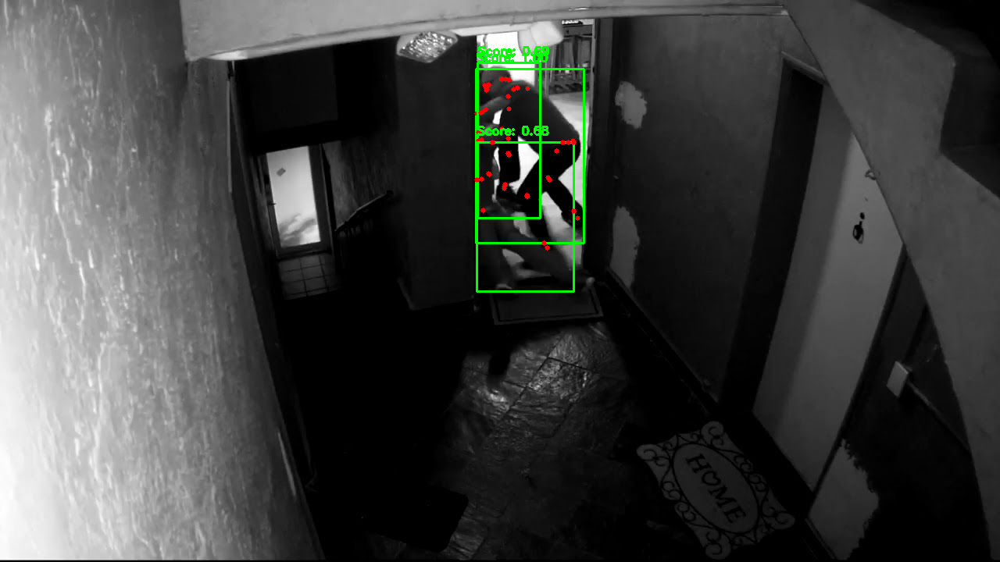

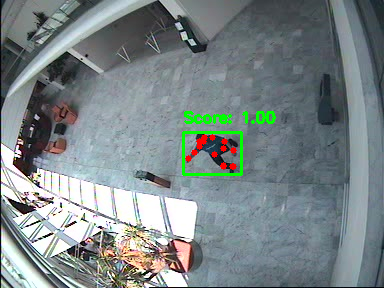

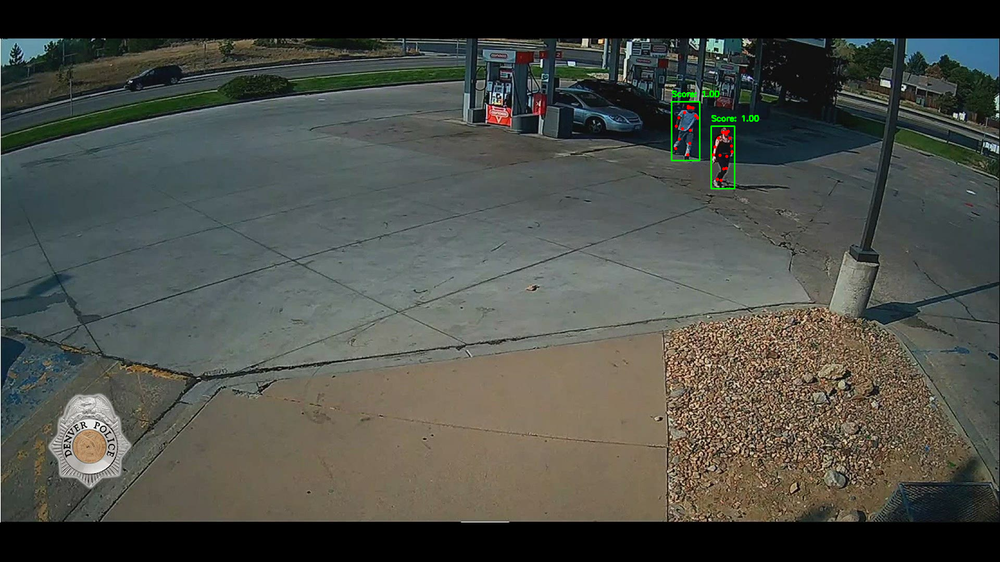

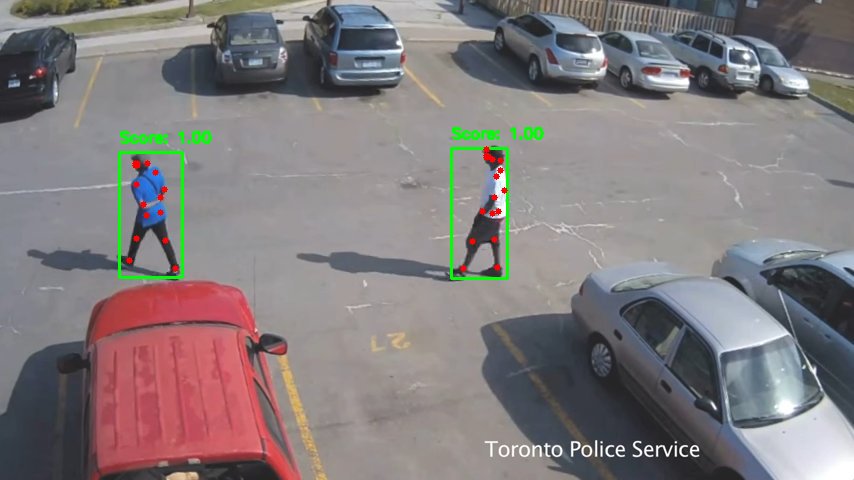

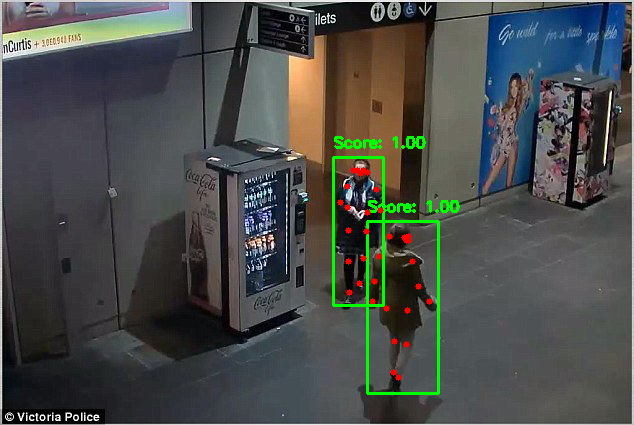

...

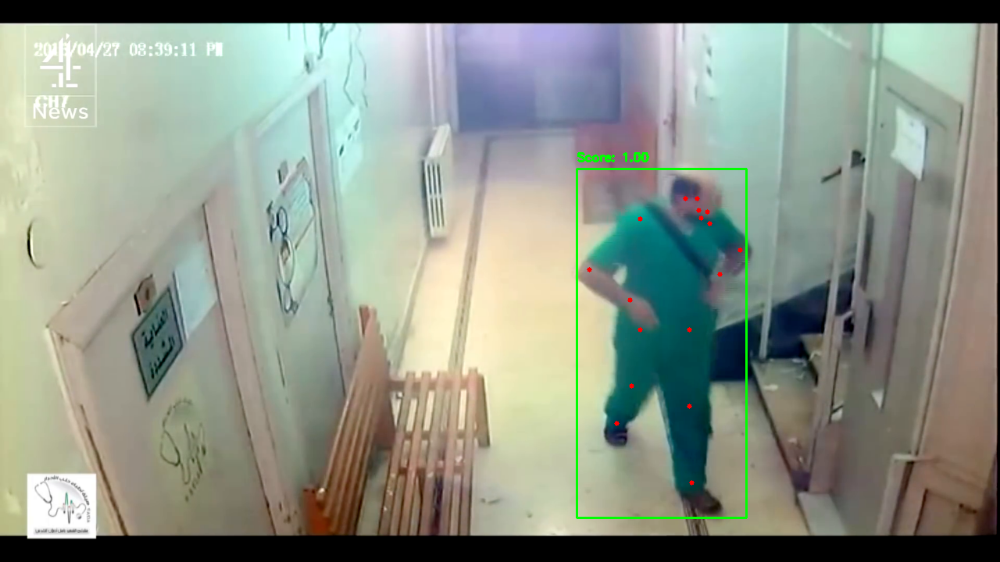

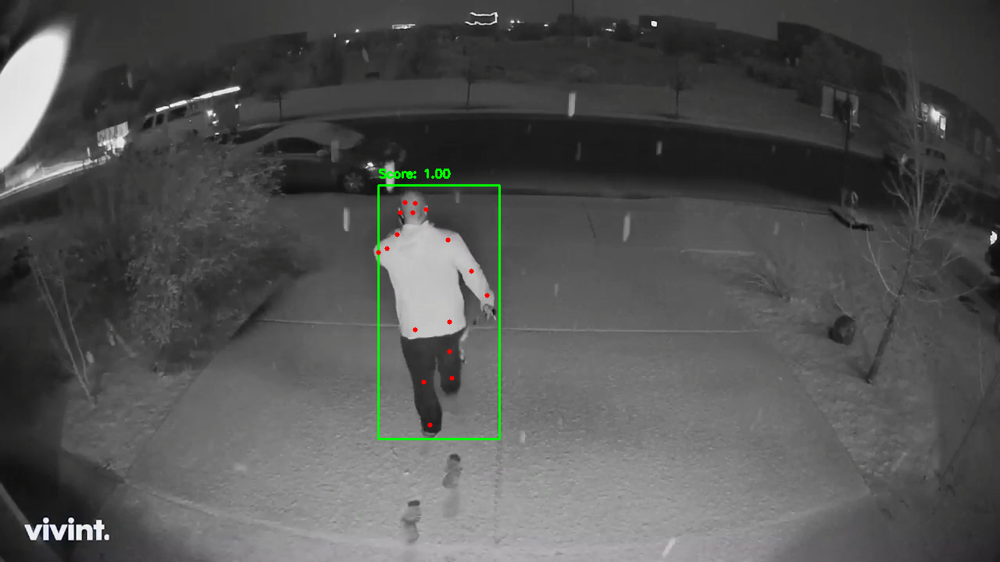

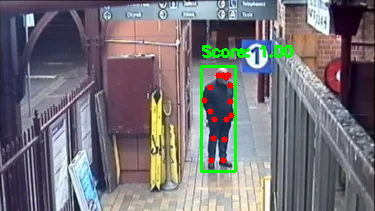

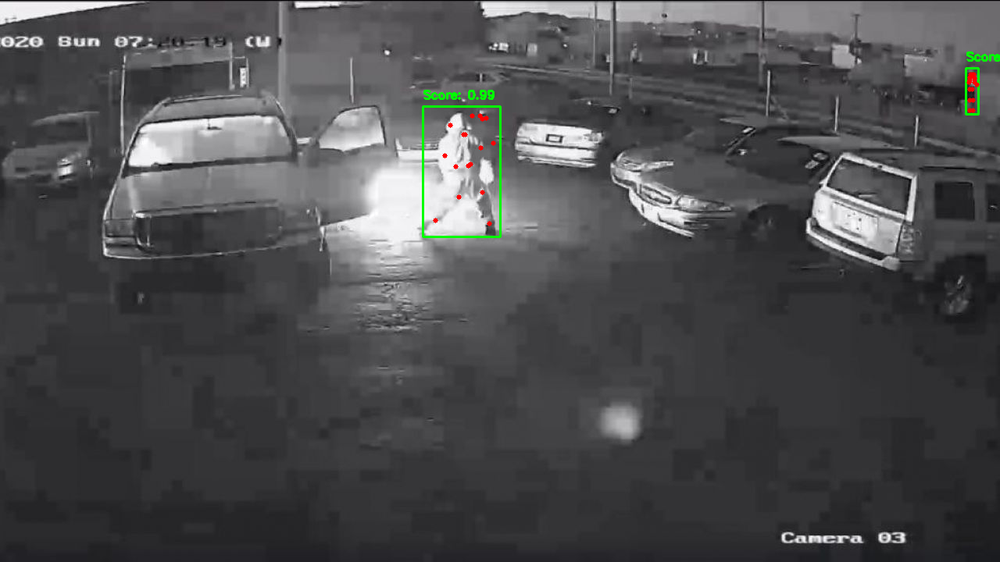

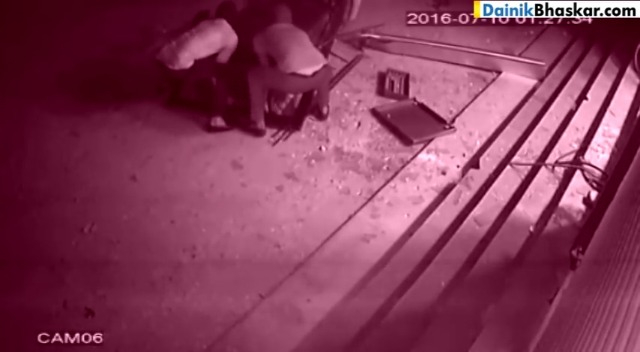

In [5]:
for i in range(0, 50):
    boxes = prediction[i]['boxes']
    keypoints = prediction[i]['keypoints']
    scores = prediction[i]['scores']
    image_np = np.array(images[i])
    boxes = boxes.numpy().astype(int)
    keypoints = keypoints.numpy().astype(int)

    for box, kp, score in zip(boxes, keypoints, scores):
        if score <= 0.6:
            continue
        # Draw bounding box
        cv2.rectangle(image_np, (box[0], box[1]), (box[2], box[3]), (0, 255, 0), 2)
        
        # Draw keypoints
        for point in kp:
            cv2.circle(image_np, (point[0], point[1]), 3, (255, 0, 0), -1)

        # Display confidence score
        cv2.putText(image_np, f"Score: {score:.2f}", (box[0], box[1] - 10),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    # Display the result image
    pil_image = Image.fromarray(image_np)
    display(pil_image)